# Helical Beam

The problem provided in this example is a strainght beam fixed on one end that is subjected to a point force and moment at the other end. The arch is modeled with 3D geometrically exact beams (i.e. Simo-Reissner Beams). For more information on beams [see here](../README.md).

<img src="helical.png" width="600">

In [1]:
from dolfin import *
import numpy as np
import matplotlib.pyplot as plt
from rotation_parametrization import ExponentialMap
from ufl import diag, Jacobian, shape
from mpl_toolkits import mplot3d

import os
os.chdir('../../../..') # change directory to main module directory
from arc_length.rotation_parametrization import ExponentialMap # import rotation paramitrization for 3D beams
from arc_length.force_control_solver import force_control # import force control formulation of arc-length solver

parameters["form_compiler"]["cpp_optimize"] = True
parameters["form_compiler"]["quadrature_degree"] = 4
parameters['reorder_dofs_serial'] = False

## Import Mesh and define function spaces

In the case of 3D beams we also paramterize the rotations to map the rotational degree of freedoms into a rotation matrix. The rotation parametrization script is obtained from the fenics tutorial: [Nonlinear beam model in finite rotations](https://comet-fenics.readthedocs.io/en/latest/demo/finite_rotation_beam/finite_rotation_nonlinear_beam.html)

In [2]:
mesh = Mesh()
with XDMFFile(os.getcwd()+'/examples/force_control/beam/beam_3D/mesh/mesh.xdmf') as infile:
    infile.read(mesh)

Ue = VectorElement("CG", mesh.ufl_cell(), 2, dim=3) # displacement
Te = VectorElement("CG", mesh.ufl_cell(), 1, dim=3) # rotation
V = FunctionSpace(mesh, MixedElement([Ue, Te]))   

v_ = TestFunction(V)
u_, theta_ = split(v_)
dv = TrialFunction(V)
v = Function(V, name="Generalized displacement")
u, theta = split(v)

VR = TensorFunctionSpace(mesh, "DG", 0, shape=(3, 3))
R_old = Function(VR, name="Previous rotation matrix")
R_old.interpolate(Constant(((1, 0, 0), (0, 1, 0), (0, 0, 1))))

V0 = VectorFunctionSpace(mesh, "DG", 0, dim=3)
curv_old = Function(V0, name="Previous curvature strain")


Vu = V.sub(0).collapse()
total_displ = Function(Vu, name="Previous total displacement")

rot_param = ExponentialMap()
R = rot_param.rotation_matrix(theta)
H = rot_param.curvature_matrix(theta)

Jac = Jacobian(mesh)
gdim = mesh.geometry().dim()
Jac = as_vector([Jac[i, 0] for i in range(gdim)])
g01 = Jac/sqrt(dot(Jac, Jac))
    
g02 = cross(as_vector([0,0,1]),g01)
g02 /= sqrt(dot(g02,g02))
    
g03 = cross(g01,g02)
g03 /= sqrt(dot(g03,g03))

r_01 = outer(g01,as_vector([1,0,0]))
r_02 = outer(g02,as_vector([0,1,0]))
r_03 = outer(g03,as_vector([0,0,1]))

R0=r_01+r_02+r_03 # Initial rotation tensor from global coordinate frame to beam orthonormal triad

def tgrad(u):
    return dot(grad(u), g01)

## Define Dirichlet Boundary Conditions

In [3]:
L = 10
def left_end(x, on_boundary):
    return near(x[0], 0)
def right_end(x, on_boundary):
    return near(x[0], L)

facets = MeshFunction("size_t", mesh, 0)
AutoSubDomain(left_end).mark(facets, 1)
AutoSubDomain(right_end).mark(facets, 2)

#-------------------------Clamp Left----------------------------------------------------------------#
bcs = [DirichletBC(V, Constant((0,)*6),left_end, method = 'pointwise')]

## Kinematics and Weak Form

In [4]:
method = "incremental"

if method == "total":
    defo = dot(R0,dot(R.T, g01 + tgrad(u)) - g01)
    curv = dot(H.T, tgrad(theta))
elif method == "incremental":
    R_new = R * R_old
    defo = dot(R0.T,dot(R_new.T, g01 + tgrad(total_displ+u)) - g01)
    curv = curv_old + dot(R_old.T * H.T, tgrad(theta))

In [5]:
# Geometrical properties
radius = Constant(0.2)
S = pi * radius ** 2
I = pi * radius ** 4 / 4

# Stiffness moduli
ES = Constant(1e4)
GS = Constant(1e4)
GS_2 = GS
GS_3 = GS
EI = Constant(1e2)
EI_2 = EI
EI_3 = EI
GJ = Constant(1e2)

In [6]:
# Constitutive Equation
C_N = diag(as_vector([ES, GS_2, GS_3]))
C_M = diag(as_vector([GJ, EI_2, EI_3]))

# Applied Loads:
M_max = Constant(200*pi)
F_max = Constant(50.)
load = Expression("t", t=0, degree=0)

ds = Measure("ds", domain=mesh, subdomain_data=facets)
dx = Measure("dx", domain=mesh)

elastic_energy = 0.5 * (dot(defo, dot(C_N, defo)) + dot(curv, dot(C_M, curv))) * dx

F_int = derivative(elastic_energy, v, v_)
F_ext = load * (- M_max* dot(H, theta_)[1] + F_max * u_[1]) * ds(2)
residual = F_int - F_ext
tangent_form = derivative(residual, v, dv)

## Solver
To use our solver we first have to define the type of solver (i.e. displacement control or force control) and solver parameters before using the solver. Note that the correct type of solver has to first be imported (see first cell).
### Solver parameters
Here the parameters for both types of solvers:

>* `psi` : the scalar arc-legth parameter. When psi = 1, the method becomes the shperical arc-length method and when psi = 0 the method becomes the cylindrical arc-length method
>* `tol` : tolerance for the linear solver
>* `lmbda0` : the initial load parameter
>* `max_iter` : maximum number of iterations for the linear solver
>* `solver` : (optional): type of linear solver for the FEniCS linear solve function -- default FEniCS linear solver is used if no argument is used.

Aside from these solver parameters, the arguments need to solve the FEA problem must also be passed into the solver:
>* `u` : the solution function
>* `F_int` : First variation of strain energy (internal nodal forces)
>* `F_ext` : Externally applied load (external applied force)
>* `J` : The Jacobian of the residual with respect to the deformation (tangential stiffness matrix)
>* `load_factor` : The incremental load factor 

The solver can be called by:
`solver = force_control(psi,tol,lmbda0,max_iter,u,F_int,F_ext,bcs,J,load_factor,solver)`

### Using the solver
1. Initialize the solver by calling solver.initialize()
2. Iteratively call solver.solve() until desired stopping condition

In [7]:
# Solver Parameters
psi = 1.0 
tol = 1.0e-6 
lmbda0 = 1/3000 
max_iter = 10
solver = 'mumps' # Optional -- Type of linear solver

# Set up arc-length solver
solver = force_control(psi=psi, tol=tol, lmbda0=lmbda0, max_iter=max_iter, u=v, 
                       F_int=F_int, F_ext=F_ext, bcs=bcs, J=tangent_form, load_factor=load, solver=solver)

### The solution update scheme for incremental formulation of 3D beams

The predictor and corrector step of our arc-length implementation follows the paper [A simple extrapolated predictor for overcoming the starting and tracking issues in the arc-length method for nonlinear structural mechanics](https://www.sciencedirect.com/science/article/pii/S014102962034356X). 

In brief, the predictor step proposed in the paper above is an extrapolator that takes in the previous two converged solution $u_{n}$ and $u_{n-1}$ to predict the new equilibrium configuration $u_{n+1}$ such that:

$$
u_{n+1}^{predicted} = [1+\alpha] u_n -\alpha u_{n-1}
$$

where $\alpha$ is the parameter that controls the adaptive load size and depends on the arc-length increment.

While the continuum problems and 2D beam formulations is able to use the predictor as is, the 3D beams incremental formulation requires a slight modification for the predictor to work. Recall that the incremental beam formulation store the previous solution such that

$$
\mathbf{r}_{n+1} = \mathbf{r}_n+\mathbf{u}
$$

$$
\mathbf{\Lambda}_{n+1} = \mathbf{\Lambda\Lambda}_n
$$

where $u_n$ smd $\Lambda_n$ denotes the solution of the previous step and $u$ and $\Lambda$ are now the incremental solution (that we are solving for) with respect to the previous solution.

To take into account the incremental solution in the arc-length update scheme, $u_{n-1} = 0$ while $u_n$ stays the same.  



In [8]:
# Start solver 
disp = [total_displ.vector()[:]] # displacement solutions
rot = [v.sub(1,True).vector()[:]] # Rotation solutions
lmbda = [0] # save load factor

while (solver.load_factor.t < 1 and solver.converged) or (solver.converged == False):
    solver.solve()
    if solver.converged:       
        if method == 'incremental':
            total_displ.vector()[:] += v.sub(0,True).vector()[:]
            R_old.assign(project(R * R_old, VR))
            curv_old.assign(project(curv, V0))

            disp.append(total_displ.vector()[:])
            rot.append(v.sub(1,True).vector()[:])
            lmbda.append(solver.load_factor.t)

            solver.u_n = v.vector().copy()-solver.u_n_1
            solver.u_n_1.zero()
        else:
            disp.append(v.sub(0,True).vector()[:])
            rot.append(v.sub(1,True).vector()[:])

Starting initial Force Control with Newton Method:
Iteration 0: 
Residual error: 2.1010e-01
Iteration 1: 
Residual error: 2.5405e+00
Iteration 2: 
Residual error: 8.1929e-08

Arc-Length Step 1 :
Iteration: 1 
|Total Norm: 8.1929e-08 |Residual Norm: 8.1929e-08 |A: 0.0000e+00|

Arc-Length Step 2 :
Iteration: 1 
|Total Norm: 1.6717e+01 |Residual Norm: 1.6717e+01 |A: 0.0000e+00|
Iteration: 2 
|Total Norm: 5.0954e-02 |Residual Norm: 1.8524e-03 |A: 5.0921e-02|
Iteration: 3 
|Total Norm: 1.7801e-04 |Residual Norm: 6.5408e-05 |A: 1.6556e-04|
Iteration: 4 
|Total Norm: 1.7338e-08 |Residual Norm: 1.6168e-08 |A: 6.2628e-09|

Arc-Length Step 3 :
Iteration: 1 
|Total Norm: 4.8623e+00 |Residual Norm: 4.8623e+00 |A: 6.2628e-09|
Iteration: 2 
|Total Norm: 9.2335e-04 |Residual Norm: 5.5090e-05 |A: 9.2171e-04|
Iteration: 3 
|Total Norm: 1.4894e-05 |Residual Norm: 4.8993e-06 |A: 1.4065e-05|
Iteration: 4 
|Total Norm: 4.4068e-09 |Residual Norm: 4.4064e-09 |A: 6.3540e-11|

Arc-Length Step 4 :
Iteration: 1 

## Post Processing

In [9]:
# Get dof coordinates:
x_dofs = V.sub(0).sub(0).dofmap().dofs()
y_dofs = V.sub(0).sub(1).dofmap().dofs()
z_dofs = V.sub(0).sub(2).dofmap().dofs()

theta_x_dofs = V.sub(1).sub(0).dofmap().dofs()
theta_y_dofs = V.sub(1).sub(1).dofmap().dofs()
theta_z_dofs = V.sub(1).sub(2).dofmap().dofs()

dofs = V.tabulate_dof_coordinates()
dof_coords = dofs.reshape((-1, 3))

eps = 1e-10

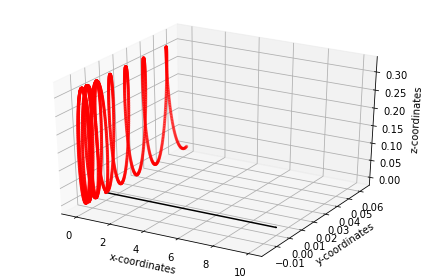

In [14]:
x_nodal_coord = dof_coords[x_dofs][:,0]
y_nodal_coord = dof_coords[y_dofs][:,1]
z_nodal_coord = dof_coords[z_dofs][:,2]

disp_x = x_nodal_coord + disp[-1][x_dofs]
disp_y = y_nodal_coord + disp[-1][y_dofs]
disp_z = z_nodal_coord + disp[-1][z_dofs]

fig = plt.figure()

ax = plt.axes(projection='3d')
ax.plot(x_nodal_coord,y_nodal_coord, z_nodal_coord, c = 'k')

ax.scatter(disp_x, disp_y, disp_z, c = 'r', marker = '.')

ax.set_xlabel('x-coordinates')
ax.set_ylabel('y-coordinates')
ax.set_zlabel('z-coordinates')

plt.tight_layout()
plt.show()

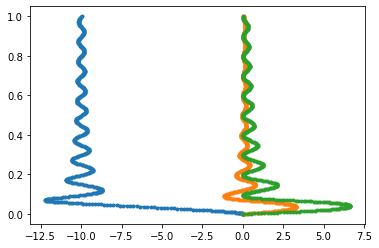

In [11]:
for ii in x_dofs:
    if abs(dof_coords[ii,0]-L) <= eps :
        force_dof_x = ii
        
for ii in y_dofs:
    if abs(dof_coords[ii,0]-L) <= eps :
        force_dof_y = ii
        
for ii in z_dofs:
    if abs(dof_coords[ii,0]-L) <= eps :
        force_dof_z = ii
        
tip_x = []
for ii in range(0,len(disp)):
    '''
    if method == 'incremental':
        tip_x.append(disp_all[ii][force_dof_x])
    else:
    '''
    tip_x.append(disp[ii][force_dof_x])

tip_y = []
for ii in range(0,len(disp)):
    '''
    if method == 'incremental':
        tip_y.append(disp_all[ii][force_dof_y])
    else:
    '''
    tip_y.append(disp[ii][force_dof_y])

tip_z = []
for ii in range(0,len(disp)):
    '''
    if method == 'incremental':
        tip_z.append(disp_all[ii][force_dof_z])
    else:
        '''
    tip_z.append(disp[ii][force_dof_z])

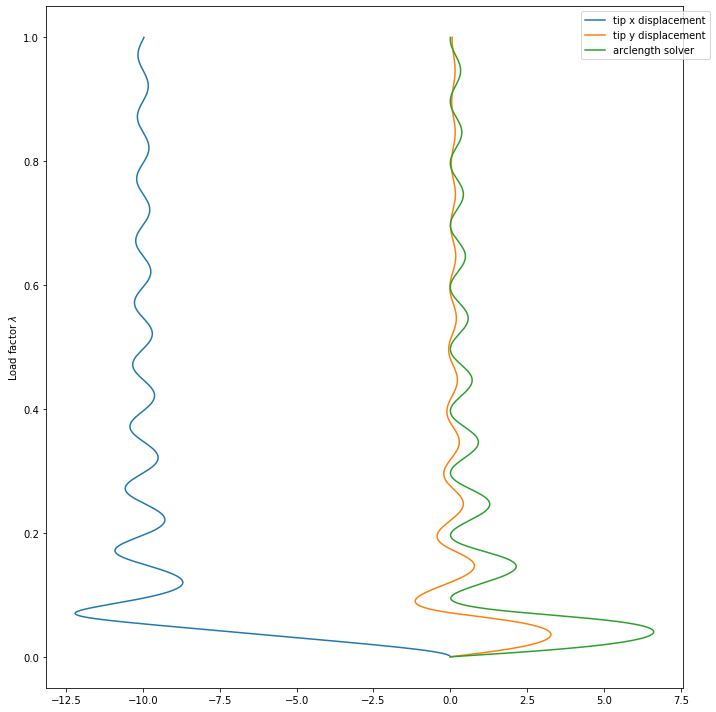

In [12]:
moment = np.linspace(0,1,4001)
plt.figure(figsize = (10,10))

plt.plot(tip_x, lmbda,label = 'tip x displacement')
plt.plot(tip_y, lmbda, label = 'tip y displacement')
plt.plot(tip_z, lmbda, label = 'arclength solver')
plt.ylabel(r'Load factor $\lambda$')
plt.legend(bbox_to_anchor=(1.05, 1))
plt.tight_layout()

## Optional: Creating an animation from solution snapshots

In [13]:
# Optional Animation
from matplotlib import animation, rc

plt.rcParams["animation.html"] = "jshtml"
plt.rcParams["animation.embed_limit"] = 31024110 # make sure there is enough memory for animation

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(111, projection='3d')

ax.set_xlim3d([-10,10])
ax.set_ylim3d([-2,2])
ax.set_zlim3d([-2, 2])

line, = ax.plot([], [], [], ls = 'None')

def drawframe(n):
    ax.cla()
    ax.set_xlim3d([-5,10])
    ax.set_ylim3d([-1,1])
    ax.set_zlim3d([-1, 1])
    disp_x = x_nodal_coord + disp[n][x_dofs]
    disp_y = y_nodal_coord + disp[n][y_dofs]
    disp_z = z_nodal_coord + disp[n][z_dofs]
    ax.plot(disp_x,disp_y,disp_z, ls = 'None', marker = '.', c='r')
    return line,

plt.close()
# blit=True re-draws only the parts that have changed.
anim = animation.FuncAnimation(fig, drawframe, frames=len(lmbda), interval=10, blit=True)
anim